<center><img src="./ntbk_contents/title_gif.gif" alt="Title GIF" /></center>

***
<center>
    <i><h3>A DEEP LEARNING APPROACH TO RECREATING ART USING STYLES OF FILIPINO PAINTERS</h3></i>
</center>

***
<a name="top"></a>
#### Table of Contents:
[ref0]: #NST
- [What is Neural Style Transfer?][ref0]

[ref1]: #Project_Implementation
- [Project Implementation][ref1]

[ref2]: #Results_and_Discussions
- [Results and Discussions][ref2]
***

Before we delve into our exploration of the captivating process of transferring artistic styles from various Filipino painters, it is crucial to grasp the essence of neural style transfer. This remarkable technique has revolutionized the realm of digital artistry, enabling us to fuse the content of one image with the distinctive visual flair of another. We will unravel the intricacies of neural style transfer, shedding light on its underlying principles and unveiling the steps involved in its implementation. So, let us embark on this creative journey as we uncover the mesmerizing world of style transfer and its application to the vibrant works of Filipino painters.

<a name="NST"></a>
# What is Neural Style Transfer?
***
Image Style Transfer is an advanced machine learning technique that enables us to create a novel image by merging the content of one photograph with the artistic style of another artwork.

<center><img src="./ntbk_contents/NST.JPG" alt="NST" height=800px width=800px /></center>
<center><em><b>Figure 1:</b> ML3 Final Presentation Slide 13 (Training Pipeline).</em></center>

According to the paper titled “[Image Style Transfer Using Convolutional Neural Networks](https://www.cv-foundation.org/openaccess/content_cvpr_2016/papers/Gatys_Image_Style_Transfer_CVPR_2016_paper.pdf)”,  the Style Transfer process involves the utilization of a pre-trained network called vgg19, and it follows these steps:

To help us visualize better, we are going to use the image uploaded by Clifford K. Yang of the vgg19 model [here](https://www.researchgate.net/figure/llustration-of-the-network-architecture-of-VGG-19-model-conv-means-convolution-FC-means_fig2_325137356).

<br>

<center><img src="./ntbk_contents/VGG19.png" alt="VGG19" height=600px width=600px /></center>
<center><em><b>Figure 2:</b> Illustration of the network architecture of VGG-19 model: conv means convolution, FC means fully connected</em></center>

1. **Obtain the Content Representation of the content image**: This involves passing the content image through the vgg19 network and retrieving the output of the conv4_2 layer.
2. **Acquire the Style Representations of the style image**: This entails passing the style image through the network and calculating a "Gram Matrix" using the output data from the convolutional layers `conv1_1`, `conv2_1`, `conv3_1`, `conv4_1`, and `conv5_1`. The Gram Matrix serves as a mathematical representation of the similarities in prominent styles between feature maps within a specific convolutional layer.
3. **Initialize a target image**: This can be achieved by either duplicating the content image, which preserves the original content and results in a more deterministic target image, or creating a white noise image, which requires more parameter adjustments.
4. **Perform a forward pass using the target image**.
5. **Calculate the Total Loss**, which combines the Content Loss (the difference between the Content Representation of the target and content images) and the Style Loss (the difference between the Style Representations of the target and style images). It's important to note that the calculation of Total Loss in Style Transfer differs from the traditional computation in Convolutional Neural Networks (ConvNets). Instead of computing a loss based on the output of the last Fully Connected Layer, the difference between Content Loss and Style Loss is calculated for the input images and the target image. Additional information on how to calculate Total Loss can be found in the Medium Post "Neural Style Transfer Tutorial - Part 1" by Vamshik Shetty.
6. **Utilize Gradient Descent to minimize the Total Loss** by adjusting the pixel values of the target image. It's worth emphasizing that the weights of the network remain fixed during the Style Transfer process. Therefore, the Total Loss is minimized by updating the pixel values of the target image, which serves as an input to the trained network. This ensures that the ContentRepresentation_target_image and StyleRepresentations_target_image become closer to the original ContentRepresentation_content_image and StyleRepresentations_style_image, respectively, which were computed prior to the training process. This aspect can be quite challenging.
7. **Repeat steps 4 and 6** for a predetermined number of iterations or until the desired target image is achieved.

Now that we have established a solid understanding of neural style transfer, let's shift our focus back to the heart of our exploration: the implementation of this fascinating technique in the context of transferring styles from different Filipino painters. Armed with the knowledge of how neural style transfer works and the steps involved in the process, we are equipped to delve into the captivating world where the rich artistic expressions of renowned Filipino painters converge.

[ref4]: #top
[Return to Table of Contents][ref4]

<a name="Project_Implementation"></a>
# Project Implementation
***

To bring this endeavor to life, our first step was data collection—a crucial phase that allowed us to curate a diverse and inspiring dataset. With great care and admiration, we gathered images of various paintings by nine exceptional Filipino artists. Each artist contributed ten distinctive works, forming a collection that showcases their unique artistic visions.

Among the luminaries included in our dataset are Yasmin Sison Ching, whose art embraces the beauty of simplicity and nature. Jose Joya's masterpieces, on the other hand, reflect a harmonious fusion of abstract and indigenous elements, captivating the viewer's imagination. The timeless art of Botong Francisco, with its rich historical narratives, reminds us of our cultural heritage, while Pacita Abad's vibrant and bold creations infuse a sense of joy and empowerment.

We also explore the artistry of Andres Barrioquinto, whose enigmatic and emotive portraits delve into the complexities of human emotion. Ang Kiukok's work combines vivid colors and sharp lines to convey thought-provoking social commentaries. Benedicto Cabrera, known as BenCab, captures the essence of Filipino life and landscapes with his distinct style.

Juan Luna, an iconic figure in Philippine art history, is renowned for his powerful and dramatic portrayals. Finally, the luminous landscapes and rural scenes painted by Fernando Amorsolo radiate a warmth and nostalgia that resonate deeply within us.

By assembling this remarkable collection of artworks, we have laid the foundation for our exploration of neural style transfer—a groundbreaking technique that merges the content of one image with the stylistic elements of another. Join us as we navigate the intricacies of this transformative process and witness the mesmerizing convergence of these exceptional Filipino artistic styles.

[ref10]: #skip
- [Skip Project Initialization][ref10]

#### Below are the step-by-step guide on how you can implement the Neural Style Transfer to your own images!

initialize artist weights: 
```python
nst = NeuralStyleTransfer(artist, device=device)
```

Available artists:
- joya: Jose Joya
- francisco: Botong Francisco
- abad: Pacita Abad
- kiukok: Ang Kiukok
- luna: Juan Luna
- amorsolo: Fernando Amorsolo

Then run the following code:
```python
if torch.cuda.is_available():
    torch.cuda.empty_cache()
    device = torch.device("cuda")
else:
    device = torch.device("cpu")
    
nst = NeuralStyleTransfer(artist, device=device)
style = load_image(style_filepath).to(nst.device)
content  = load_image(content_filepath).to(nst.device)
nst.set_seed()
target = content.clone().requires_grad_(True).to(nst.device)
best_loss, best_target = nst.generate_style_transfer(target,
                                                     content,
                                                     style)
```

It is important to empty the cache of the device every run to prevent memory errors.

To display best output from training, run the following:

```python
print("Best Loss:", best_loss.item())
plt.imshow(nst.im_convert(best_target))
plt.axis('off')
plt.show()
```

In [1]:
import style_transfer
from style_transfer import NeuralStyleTransfer
import importlib
import os
import torch
from PIL import Image
from torchvision import transforms, models
import matplotlib.pyplot as plt
import numpy as np
import math

In [2]:
### Helper Functions

def load_image(img_path, max_size=400, shape=None):
    image = Image.open(img_path).convert('RGB')
    if max(image.size) > max_size:
        size = max_size
    else:
        size = max(image.size)
    
    if shape is not None:
        size = shape
        
    in_transform = transforms.Compose([
                        transforms.Resize(size),
                        transforms.ToTensor(),
                        transforms.Normalize((0.485, 0.456, 0.406), 
                                             (0.229, 0.224, 0.225))])
    image = in_transform(image)[:3,:,:].unsqueeze(0)
    
    return image

In [3]:
if torch.cuda.is_available():
    torch.cuda.empty_cache()
    device = torch.device("cuda")
else:
    device = torch.device("cpu")

In [4]:
nst = NeuralStyleTransfer('kiukok', device=device)

Style Transfer Network for kiukok


In [5]:
best_targets = []
best_losses = []

In [6]:
style_filepath = "final_project/filipino_artists/ang_kiukok/untitled_dogs_2000.jpg"
content_filepath = "final_project/content_images/Mona_Lisa,_by_Leonardo_da_Vinci,_from_C2RMF_retouched.jpg"
style = load_image(style_filepath).to(nst.device)
content  = load_image(content_filepath).to(nst.device)

<a name="skip"></a>
## Reference Content Image
***

We carefully select a content image that is immediately recognizable to anybody. In this case, we used the famous painting by Leonardo Da Vinci, the Mona Lisa. By incorporating this image into our exploration of neural style transfer, we aim to help people better understand and appreciate the styles of our Filipino artists by using a very relatable subject.

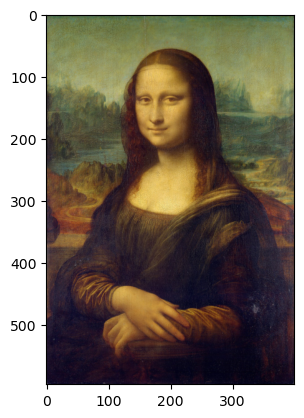

In [7]:
plt.imshow(nst.im_convert(content));

<a name="a_toc"></a>
To help us get to know more about the different artists, here is a table for all that are present in our project.
***
##### Artists Table of Contents

[ref4]: #kiukok
- [Ang Kiukok][ref4]

[ref5]: #luna
- [Juan Luna][ref5]

[ref6]: #amorsolo
- [Fernando Amorsolo][ref6]

[ref7]: #joya
- [Jose Joya][ref7]

[ref9]: #francisco
- [Botong Francisco][ref9]

[ref11]: #abad
- [Pacita Abad][ref11]

[ref13]: #summary
- [Summary of All Artists][ref13]
***

<a name="kiukok"></a>
### Ang Kiukok
***
Ang Kiukok was a Filipino painter known for his expressive, Cubist-like works. He often chose dynamic or disturbing subject matter, frequently depicting rabid dogs, crucifixions, and screaming figures in an abstracted geometric style. When asked why he often chose subjects full of such angry he once replied "Why not? Open your eyes. Look around you. So much anger, sorrow, ugliness. And also madness."
<br>
<br>
<!-- <center><img src="./ntbk_contents/gif_kiukok.gif" alt="Title GIF" height=400px width=400px/></center> -->

Below is how we implemented the style transfer from the "untitled_dogs_2000" painting of Ang Kiukok.

Style Transfer Network for kiukok
Seed for torch, GPU, and backend set to: 143
Epoch:  1000
Total loss:  7267332096.0


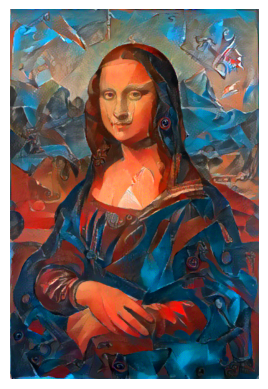

Epoch:  2000
Total loss:  5863514624.0


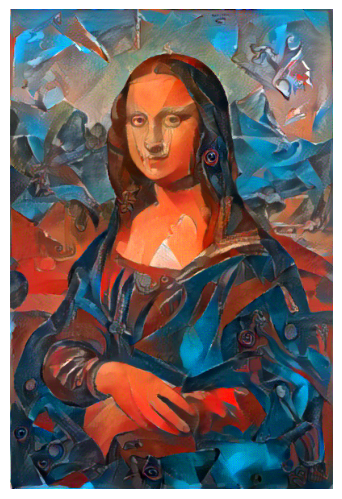

Epoch:  3000
Total loss:  5177823232.0


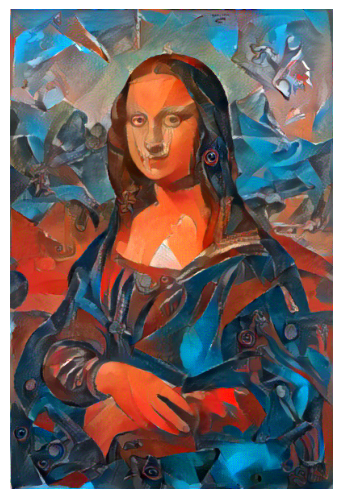

Epoch:  4000
Total loss:  17203372032.0


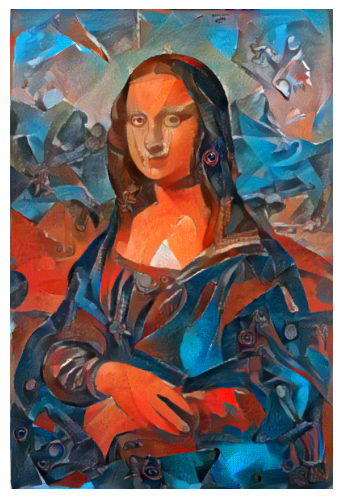

Epoch:  5000
Total loss:  5231027712.0


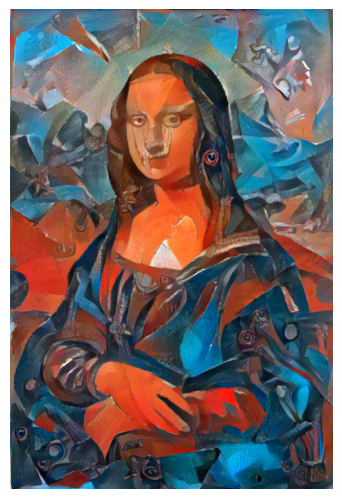

Epoch:  6000
Total loss:  5713302016.0


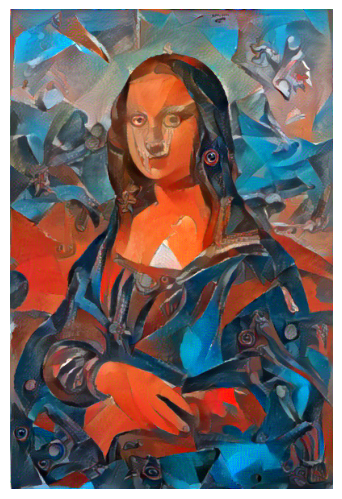

Epoch:  7000
Total loss:  3985208064.0


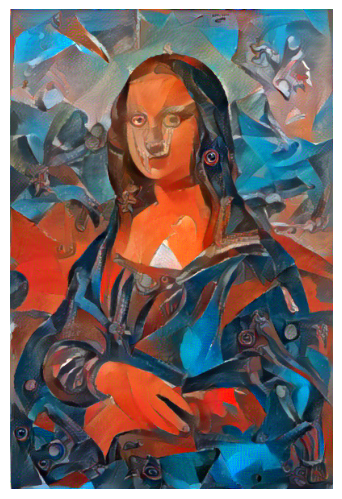

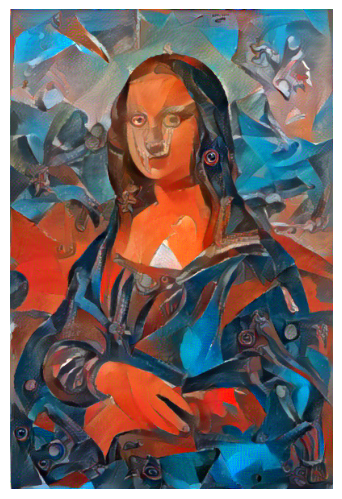

In [8]:
style_filepath = "final_project/filipino_artists/ang_kiukok/untitled_dogs_2000.jpg"
content_filepath = "final_project/content_images/Mona_Lisa,_by_Leonardo_da_Vinci,_from_C2RMF_retouched.jpg"
if torch.cuda.is_available():
    torch.cuda.empty_cache()
    device = torch.device("cuda")
else:
    device = torch.device("cpu")
    
nst = NeuralStyleTransfer('kiukok', device=device)
style = load_image(style_filepath).to(nst.device)
content  = load_image(content_filepath).to(nst.device)
nst.set_seed()
target = content.clone().requires_grad_(True).to(nst.device)
best_loss, best_target = nst.generate_style_transfer(target,
                                                     content,
                                                     style)
best_losses.append(best_loss)
best_targets.append(best_target)

[ref20]: #a_toc
[Return to All Artists][ref20]

<a name="luna"></a>
### Juan Luna
***
In 1883 Luna started the painting demanded of him by the Ayuntamiento. In May 1884, he shipped the large canvas of the Spoliarium to Madrid for the year's Exposición Nacional de Bellas Artes. He was the first recipient of the three gold medals awarded in the exhibition and Luna gained recognition among the connoisseurs and art critics present.
<br>
<br>
<!-- <center><img src="./ntbk_contents/gif_luna.gif" alt="Title GIF" height=400px width=400px/></center> -->

Below is how we implemented the style transfer from the "luna_hymen" painting of Juan Luna.

Style Transfer Network for luna
Seed for torch, GPU, and backend set to: 143
Epoch:  50
Total loss:  41566429184.0


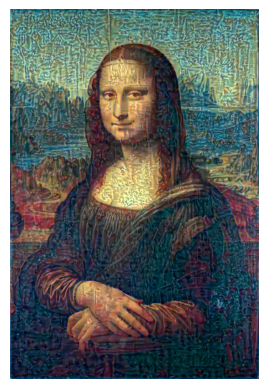

Epoch:  100
Total loss:  16161114112.0


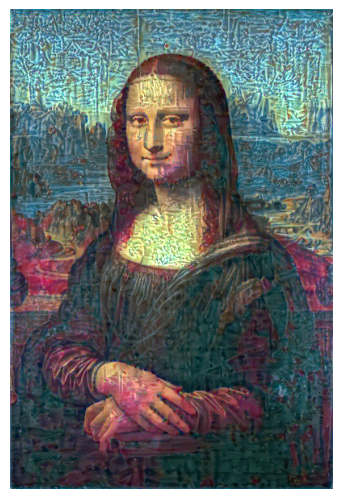

Epoch:  150
Total loss:  8958453760.0


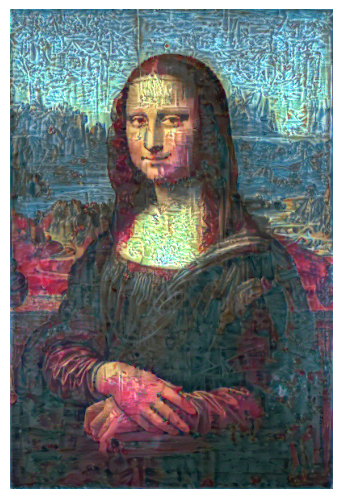

Epoch:  200
Total loss:  6053251072.0


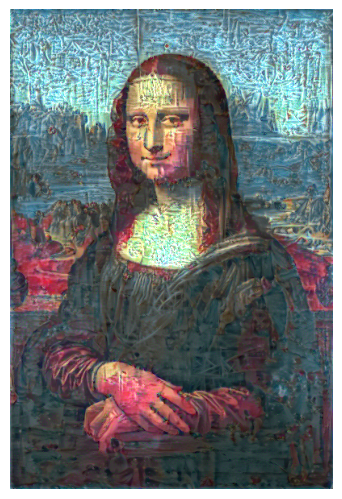

Epoch:  250
Total loss:  4673348096.0


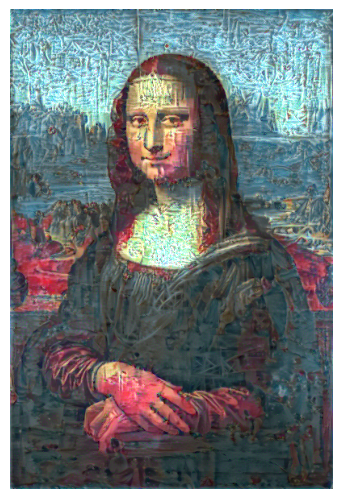

Epoch:  300
Total loss:  3881342720.0


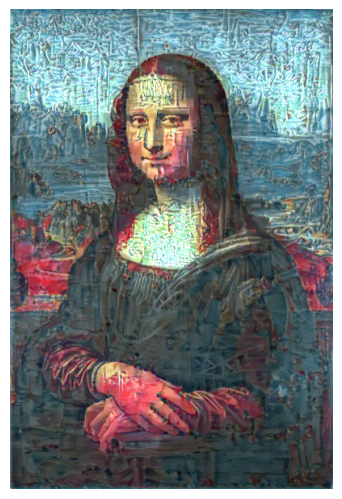

Epoch:  350
Total loss:  3370269184.0


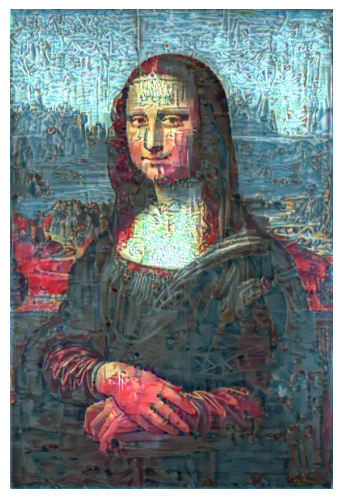

Epoch:  400
Total loss:  2955624704.0


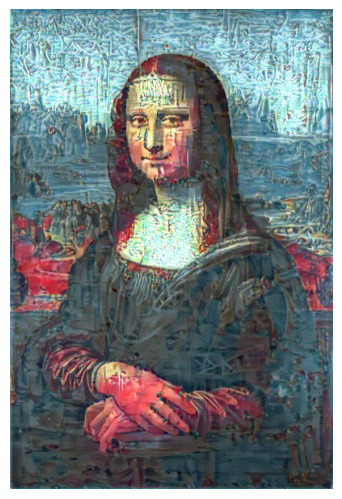

Epoch:  450
Total loss:  2661295616.0


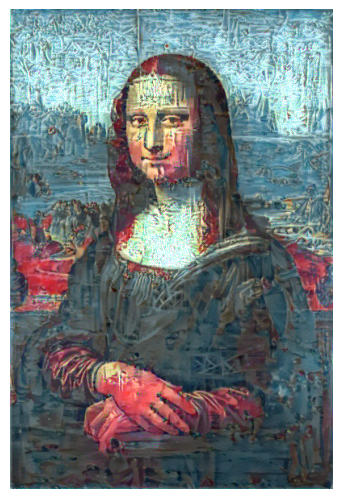

Epoch:  500
Total loss:  2509199616.0


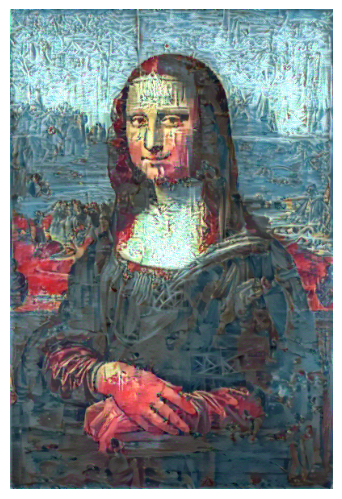

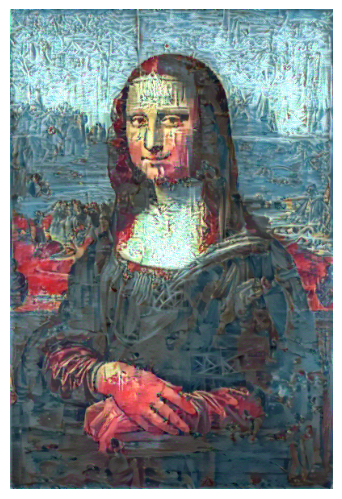

In [9]:
style_filepath = "final_project/filipino_artists/juan_luna/luna_hymen.jpg"
content_filepath = "final_project/content_images/Mona_Lisa,_by_Leonardo_da_Vinci,_from_C2RMF_retouched.jpg"
if torch.cuda.is_available():
    torch.cuda.empty_cache()
    device = torch.device("cuda")
else:
    device = torch.device("cpu")
    
nst = NeuralStyleTransfer('luna', device=device)
style = load_image(style_filepath).to(nst.device)
content  = load_image(content_filepath).to(nst.device)
nst.set_seed()
target = content.clone().requires_grad_(True).to(nst.device)
best_loss, best_target = nst.generate_style_transfer(target,
                                                     content,
                                                     style,
                                                     show=50,
                                                     steps=500,
                                                     save_interval=50
                                                     )
best_losses.append(best_loss)
best_targets.append(best_target)

[ref20]: #a_toc
[Return to All Artists][ref20]

<a name="amorsolo"></a>
### Fernando Amorsolo
***
Fernando Amorsolo y Cueto was the Philippines’ first National Artist and is officially recognized as the “Grand Old Man of Philippine Art”. Renowned for his trademark luminosity and ability to render the iconic provincial Filipina, Amorsolo’s paintings usually feature scenes in glowing rural landscapes such as farmers ankle-deep in rice fields, women in colorful baro’t sayas sorting through mangoes, and vibrant society portraits.
<br>
<br>
<!-- <center><img src="./ntbk_contents/gif_amorsolo.gif" alt="Title GIF" height=400px width=400px/></center> -->

Below is how we implemented the style transfer from the "0197" painting of Fernando Amorsolo.

Style Transfer Network for amorsolo
Seed for torch, GPU, and backend set to: 143
Epoch:  100
Total loss:  3400050944.0


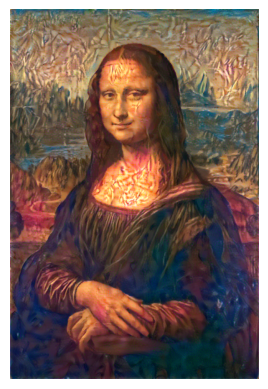

Epoch:  200
Total loss:  1851135616.0


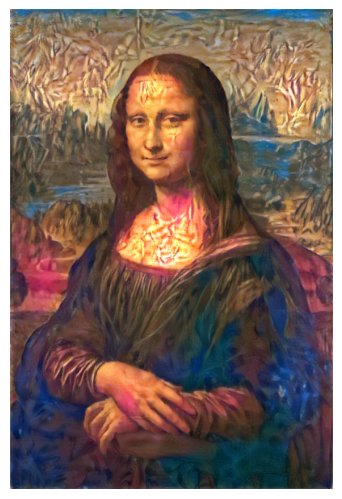

Epoch:  300
Total loss:  1326071040.0


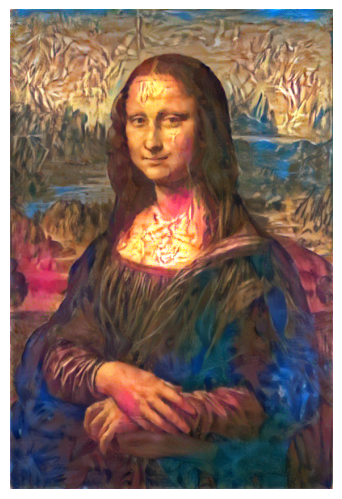

Epoch:  400
Total loss:  905048704.0


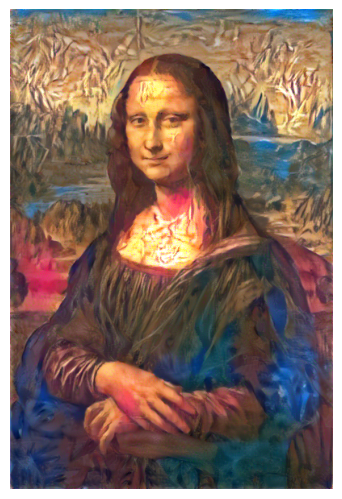

Epoch:  500
Total loss:  967721024.0


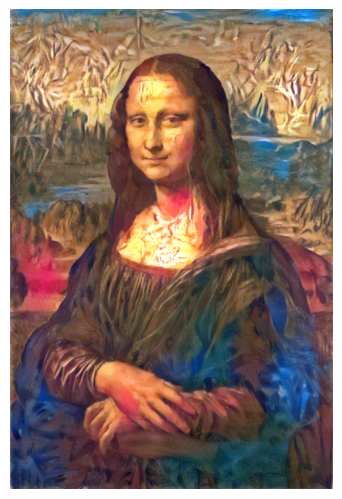

Epoch:  600
Total loss:  629177920.0


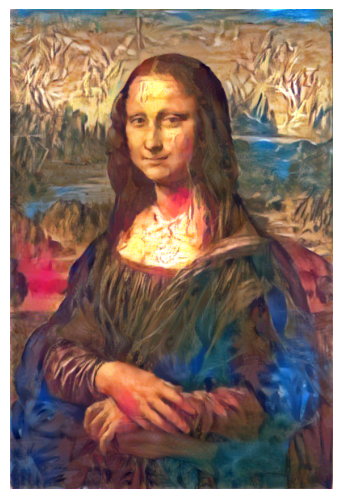

Epoch:  700
Total loss:  549808768.0


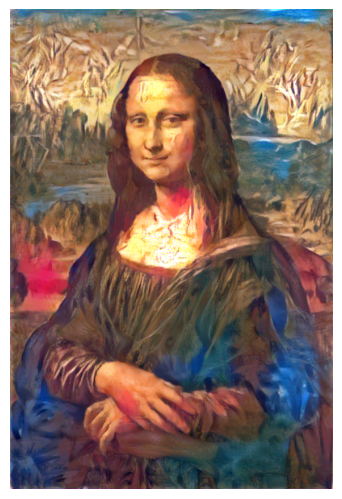

Epoch:  800
Total loss:  1708402432.0


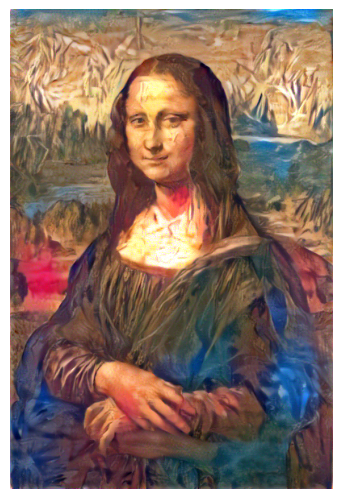

Epoch:  900
Total loss:  483944992.0


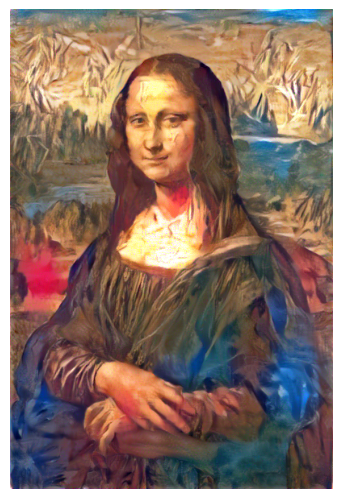

Epoch:  1000
Total loss:  441815808.0


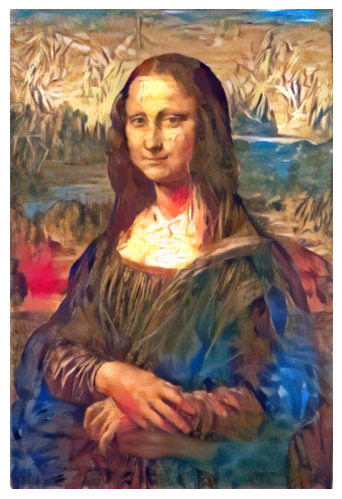

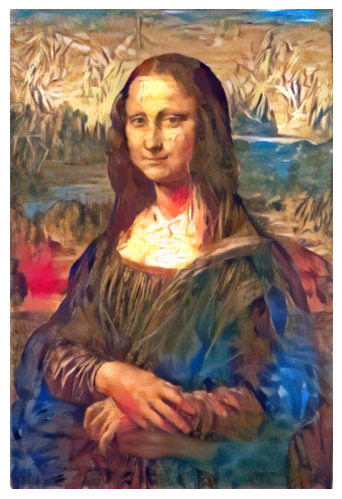

In [10]:
style_filepath = "final_project/filipino_artists/fernando_amorsolo/IMG_0197.jpg"
content_filepath = "final_project/content_images/Mona_Lisa,_by_Leonardo_da_Vinci,_from_C2RMF_retouched.jpg"
if torch.cuda.is_available():
    torch.cuda.empty_cache()
    device = torch.device("cuda")
else:
    device = torch.device("cpu")
    
nst = NeuralStyleTransfer('amorsolo', device=device)
style = load_image(style_filepath).to(nst.device)
content  = load_image(content_filepath).to(nst.device)
nst.set_seed()
target = content.clone().requires_grad_(True).to(nst.device)
best_loss, best_target = nst.generate_style_transfer(target,
                                                     content,
                                                     style,
                                                     show=100,
                                                     steps=1000,
                                                     save_interval=100
                                                     )
best_losses.append(best_loss)
best_targets.append(best_target)

[ref20]: #a_toc
[Return to All Artists][ref20]

<a name="joya"></a>
### Jose Joya
***
Born in Manila on June 3, 1931, Jose Joya is considered the pioneer and foremost abstract expressionist painter of the Philippines. His work is “characterized by calligraphic gestures and linear forces, and a sense of color vibrancy emanating from an Oriental sensibility.” The spectrum of colors native to the tropical Philippine landscape are believed to have been the source of Joya’s vibrant, yet harmonious palette.
<br>
<br>
<!-- <center><img src="./ntbk_contents/gif_joya.gif" alt="Title GIF" height=400px width=400px/></center> -->

Below is how we implemented the style transfer from the "josé-joya-father-and-daughters-1992" painting of Jose Joya.

Style Transfer Network for joya
Seed for torch, GPU, and backend set to: 143
Epoch:  1000
Total loss:  1182565376.0


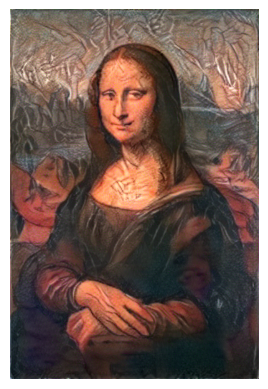

Epoch:  2000
Total loss:  740265280.0


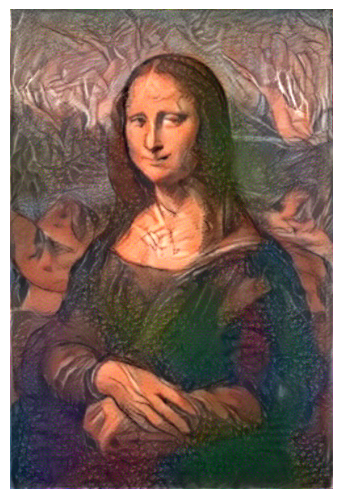

Epoch:  3000
Total loss:  450267360.0


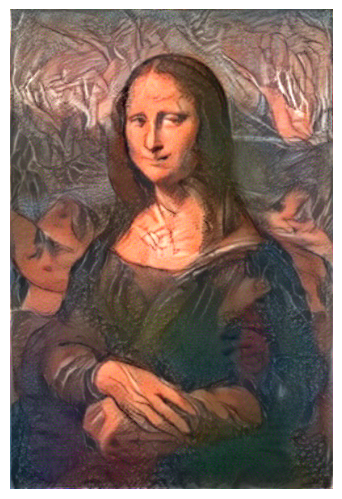

Epoch:  4000
Total loss:  1406559616.0


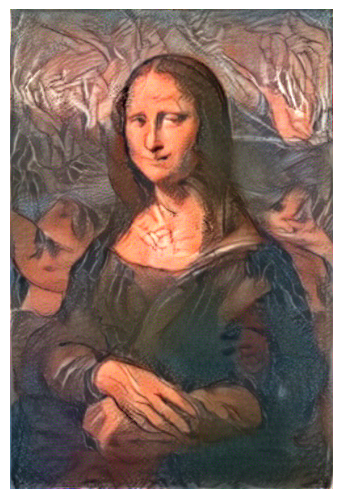

Epoch:  5000
Total loss:  597739328.0


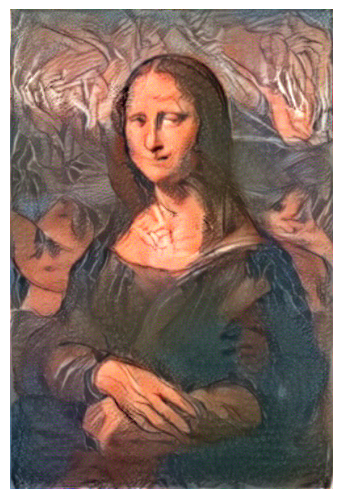

Epoch:  6000
Total loss:  239275600.0


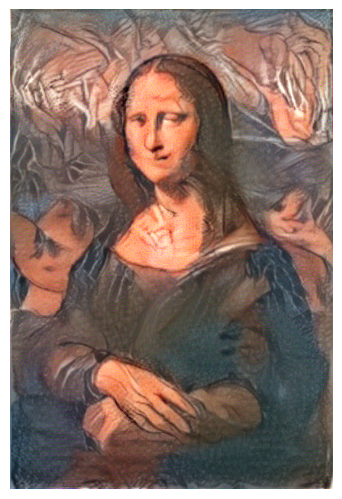

Epoch:  7000
Total loss:  370777344.0


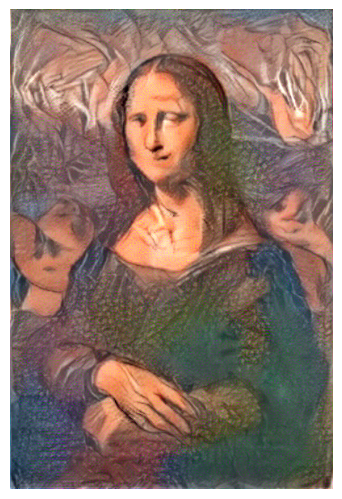

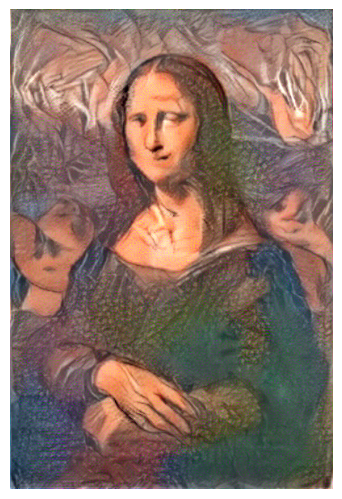

In [12]:
style_filepath = "final_project/filipino_artists/jose_joya/josВ-joya-father-and-daughters-1992.jpg"
content_filepath = "final_project/content_images/Mona_Lisa,_by_Leonardo_da_Vinci,_from_C2RMF_retouched.jpg"
if torch.cuda.is_available():
    torch.cuda.empty_cache()
    device = torch.device("cuda")
else:
    device = torch.device("cpu")
    
nst = NeuralStyleTransfer('joya', device=device)
style = load_image(style_filepath).to(nst.device)
content  = load_image(content_filepath).to(nst.device)
nst.set_seed()
target = content.clone().requires_grad_(True).to(nst.device)
best_loss, best_target = nst.generate_style_transfer(target,
                                                     content,
                                                     style)
best_losses.append(best_loss)
best_targets.append(best_target)

[ref20]: #a_toc
[Return to All Artists][ref20]

<a name="francisco"></a>
### Botong Francisco
***
Francisco was a most distinguished practitioner of mural painting for many decades and best known for his historical pieces. He was one of the first Filipino modernists along with Galo Ocampo and Victorio C. Edades who broke away from Fernando Amorsolo's romanticism of Philippine scenes. According to restorer Helmuth Josef Zotter, Francisco's art "is a prime example of linear painting where lines and contours appear like cutouts."
<br>
<br>
<!-- <center><img src="./ntbk_contents/gif_francisco.gif" alt="Title GIF" height=400px width=400px/></center> -->

Below is how we implemented the style transfer from the "francisco-harana_1957" painting of Botong Francisco.

Style Transfer Network for francisco
Seed for torch, GPU, and backend set to: 143
Epoch:  1000
Total loss:  558266816.0


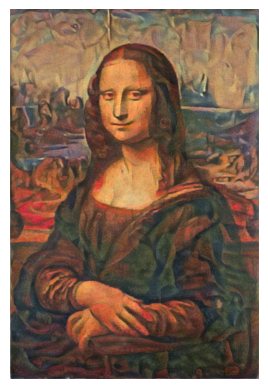

Epoch:  2000
Total loss:  80033352.0


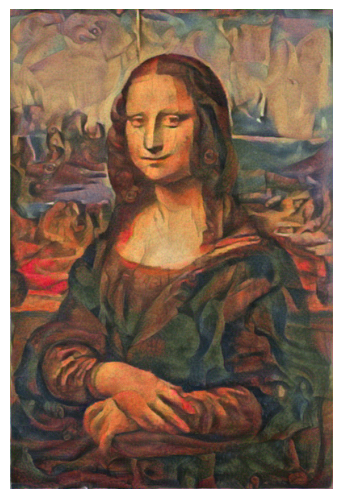

Epoch:  3000
Total loss:  575706880.0


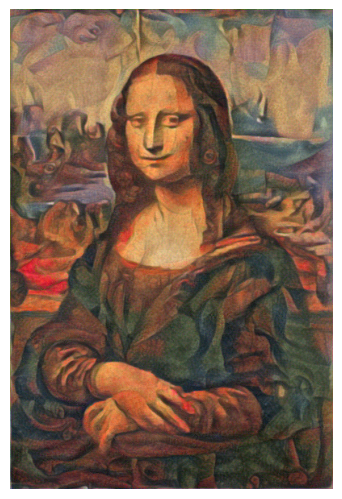

Epoch:  4000
Total loss:  58693908.0


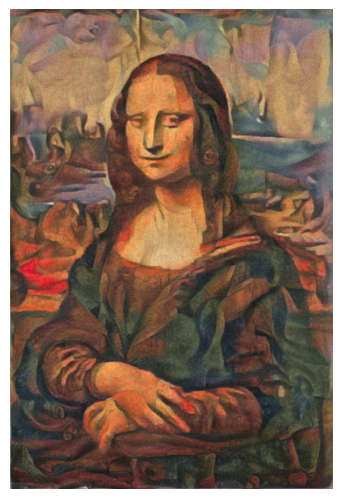

Epoch:  5000
Total loss:  94010360.0


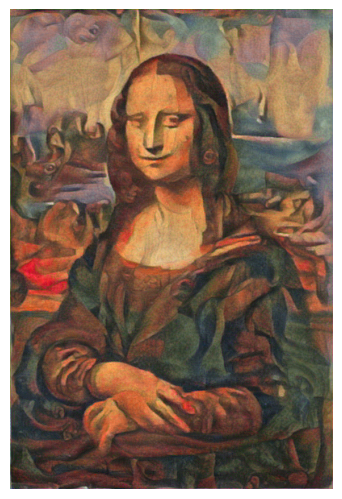

Epoch:  6000
Total loss:  76304800.0


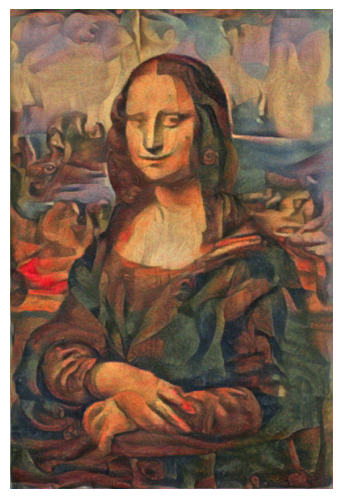

Epoch:  7000
Total loss:  58254108.0


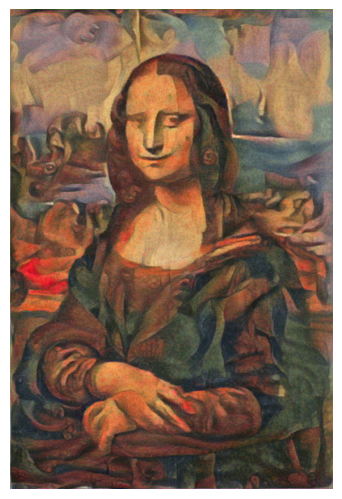

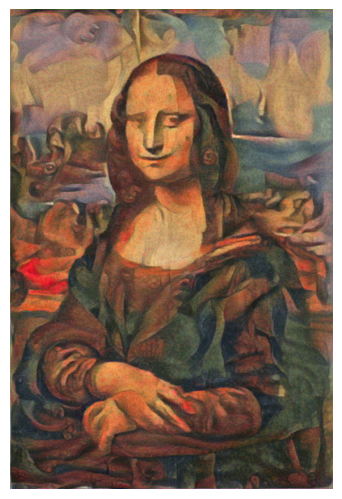

In [13]:
style_filepath = "final_project/filipino_artists/botong_francisco/francisco-harana_1957.jpg"
content_filepath = "final_project/content_images/Mona_Lisa,_by_Leonardo_da_Vinci,_from_C2RMF_retouched.jpg"
if torch.cuda.is_available():
    torch.cuda.empty_cache()
    device = torch.device("cuda")
else:
    device = torch.device("cpu")
    
nst = NeuralStyleTransfer('francisco', device=device)
style = load_image(style_filepath).to(nst.device)
content  = load_image(content_filepath).to(nst.device)
nst.set_seed()
target = content.clone().requires_grad_(True).to(nst.device)
best_loss, best_target = nst.generate_style_transfer(target,
                                                     content,
                                                     style)
best_losses.append(best_loss)
best_targets.append(best_target)

[ref20]: #a_toc
[Return to All Artists][ref20]

<a name="abad"></a>
### Pacita Abad
***
Characterized by vibrant color and accumulated material, these large scale trapunto paintings traverse a diversity of subject matter: from tribal masks and social realist tableaus depicting the individuals and communities that Pacita encountered throughout her travels, to lush and intricately constructed underwater compositions and abstractions. She lived and travelled in a bewildering amount of countries - from Bangladesh to Sudan, Bangkok to Manila, Jakarta to Yemen, Washington D.C. to Singapore - and it is this itineracy that has defined and shaped her subject matter. Pacita's work brought together images and experiences across cultures, economies and histories and offered reflections on the global long before the discourses of globalization and transnationalism were felt in the art world.
<br>
<br>
<!-- <center><img src="./ntbk_contents/gif_abad.gif" alt="Title GIF" height=400px width=400px/></center> -->

Below is how we implemented the style transfer from the "pacitaabad-underwater-wilderness-anilao-at-its-best-1986" painting of Pacita Abad.

Style Transfer Network for abad
Seed for torch, GPU, and backend set to: 143
Epoch:  1000
Total loss:  938869568.0


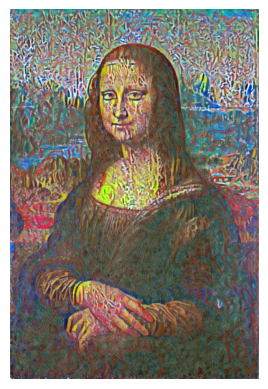

Epoch:  2000
Total loss:  490696576.0


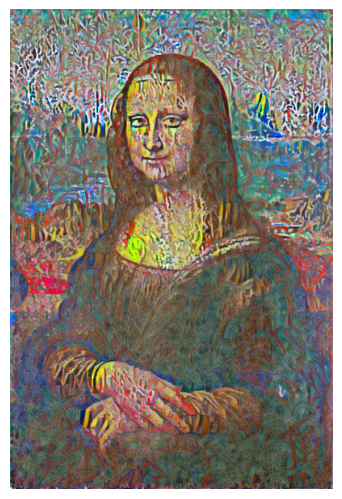

Epoch:  3000
Total loss:  388638944.0


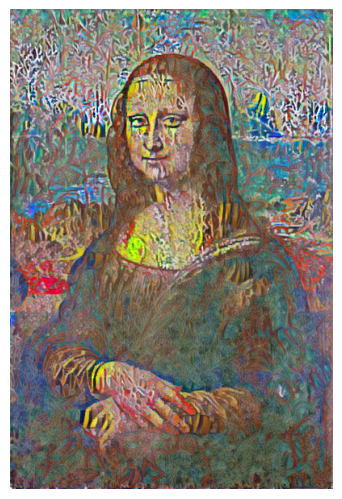

Epoch:  4000
Total loss:  313092096.0


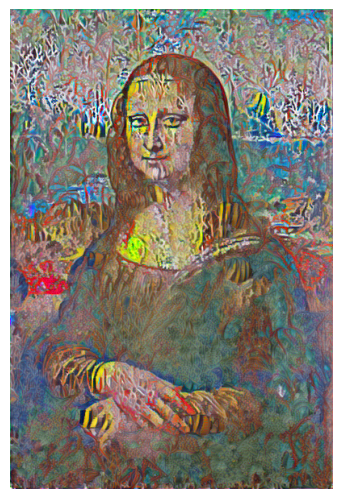

Epoch:  5000
Total loss:  260986176.0


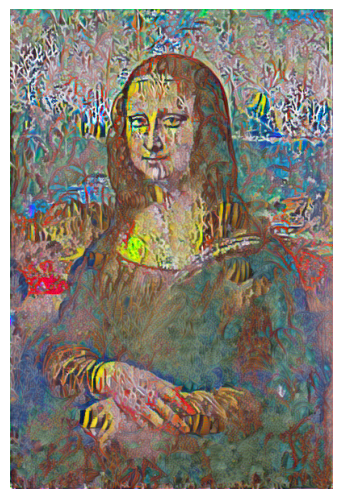

Epoch:  6000
Total loss:  281136064.0


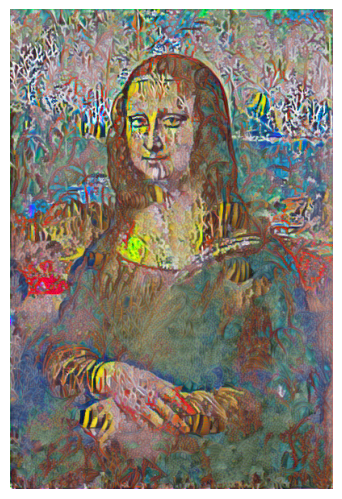

Epoch:  7000
Total loss:  1353811328.0


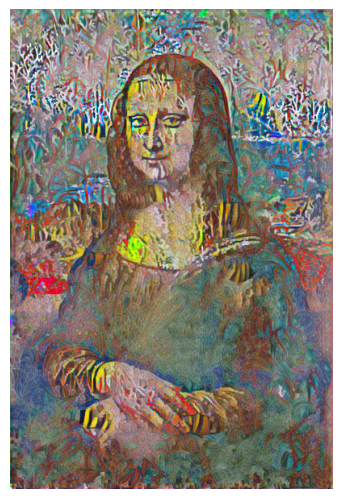

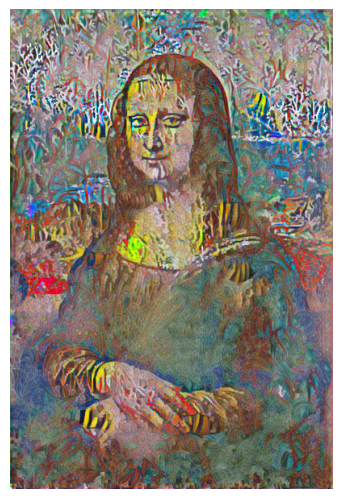

In [14]:
style_filepath = "final_project/filipino_artists/pacita_abad/pacitaabad-underwater-wilderness-anilao-at-its-best-1986.jpg"
content_filepath = "final_project/content_images/Mona_Lisa,_by_Leonardo_da_Vinci,_from_C2RMF_retouched.jpg"
if torch.cuda.is_available():
    torch.cuda.empty_cache()
    device = torch.device("cuda")
else:
    device = torch.device("cpu")
    
nst = NeuralStyleTransfer('abad', device=device)
style = load_image(style_filepath).to(nst.device)
content  = load_image(content_filepath).to(nst.device)
nst.set_seed()
target = content.clone().requires_grad_(True).to(nst.device)
best_loss, best_target = nst.generate_style_transfer(target,
                                                     content,
                                                     style)
best_losses.append(best_loss)
best_targets.append(best_target)

[ref20]: #a_toc
[Return to All Artists][ref20]

<a name="summary"></a>
### Summary Results of All Artists
***
The application of neural style transfer to the artworks of the nine Filipino artists yields fascinating results. The distinct styles of each artist blend harmoniously with the content images, creating captivating and unique compositions. This experiment showcases the versatility and potential of neural style transfer as a tool for artistic expression and innovation. The fusion of artistic styles from various Filipino painters opens up exciting possibilities for creating visually stunning and dynamic artwork.

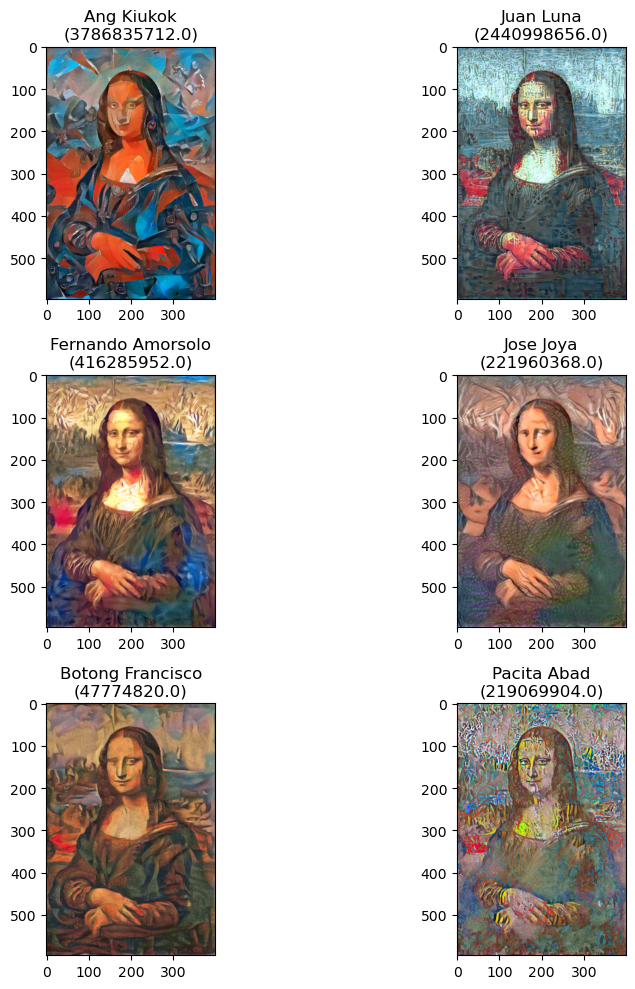

In [16]:
artists = [
    'Ang Kiukok', 'Juan Luna',
    'Fernando Amorsolo', 'Jose Joya',
    'Botong Francisco', 'Pacita Abad'
]
fig, ax = plt.subplots(3, 2, figsize=(10, 10))

for i in range(6):
    x = math.floor(i/2)
    y = i%2
    ax[x][y].imshow(nst.im_convert(best_targets[i]))
    ax[x][y].set_title(artists[i] + '\n' + f"({best_losses[i].item()})")
fig.tight_layout()

[ref20]: #a_toc
[Return to All Artists][ref20]

[ref4]: #top
[Return to Table of Contents][ref4]

<a name="Results_and_Discussions"></a>
## Results and Discussions
***

In the realm of art, the possibilities are boundless, and with the aid of deep learning, we are empowered to `REIMAGINE` images through the unique styles of Filipino artists. By leveraging neural style transfer, we have the remarkable opportunity to reconnect with the artistic heritage of our own Filipino masters, whose invaluable contributions may have been forgotten with the passage of time. This process allows us to breathe new life into their art, reviving their profound narratives and cultural significance.

As we witness images through the lens of Filipino artistic expression, a powerful transformation occurs. We not only `RECONNECT` with our heritage, arts, and culture, but we also have the ability to `REVITALIZE` the interest of the youth in these realms. The fusion of art and technology sparks a renewed appreciation for our rich artistic heritage, encouraging the younger generation to explore, celebrate, and preserve our cultural legacy.

To quote the inspiring words of <i>John Keating from the movie "Dead Poets Society"</i>:
> "We read and write poetry because we are members of the human race. And the human race is filled with passion. And medicine, law, business, engineering, these are noble pursuits and necessary to sustain life. But poetry, beauty, romance, love, these are what we stay alive for." 

Similarly, through the harmonious blending of artistry and technology, we breathe new life into the artistic realm, rekindling our passion and allowing the beauty and romance of Filipino art to resonate with all who encounter it.

[ref4]: #top
[Return to Table of Contents][ref4]

**Blog Authors:**
***
- Bundoc, Sebastian Felipe R.
- Escalante, Sean Oliver
- Lopez, Van Julius Leander G.
- Yap-III, Leo Isaiah P.

**References:**
***
[1] Rattanakun, N. (n.d.). StyleTransfer.py. GitHub. Retrieved June 15, 2023, from https://github.com/nongnoochr/dl_styletransfer_experiment/blob/master/src/StyleTransfer.py

[2] Pluralsight. (n.d.). Artistic Neural Style Transfer with Pytorch. Retrieved June 15, 2023, from https://www.pluralsight.com/guides/artistic-neural-style-transfer-with-pytorch

[3] Gatys, L. A., Ecker, A. S., & Bethge, M. (2016). Image Style Transfer Using Convolutional Neural Networks. In Proceedings of the IEEE Conference on Computer Vision and Pattern Recognition (pp. 2414-2423). Retrieved June 15, 2023, from https://www.cv-foundation.org/openaccess/content_cvpr_2016/papers/Gatys_Image_Style_Transfer_CVPR_2016_paper.pdf

[4] ResearchGate. (n.d.). Illustration of the network architecture of VGG-19 model. Retrieved June 15, 2023, from https://www.researchgate.net/figure/llustration-of-the-network-architecture-of-VGG-19-model-conv-means-convolution-FC-means_fig2_325137356

[5] Artnet. (n.d.). Ang Kiukok. Retrieved June 15, 2023, from https://www.artnet.com/artists/ang-kiukok/

[6] Wikipedia. (n.d.). Juan Luna. Retrieved June 15, 2023, from https://en.wikipedia.org/wiki/Juan_Luna

[7] Ateneo Art Gallery. (n.d.). Fernando Amorsolo. Retrieved June 15, 2023, from https://ateneoartgallery.com/artist/fernando-amorsolo

[8] Philippine Art Gallery. (n.d.). Jose Joya. Retrieved June 15, 2023, from https://www.philippineartgallery.com/jose-joya.html

[9] WikiArt. (n.d.). Botong Francisco. Retrieved June 15, 2023, from https://www.wikiart.org/en/botong-francisco

[10] Abad, P. (n.d.). About. Retrieved June 15, 2023, from https://pacitaabad.com/about/

[ref4]: #top
[Return to Table of Contents][ref4]